<a href="https://colab.research.google.com/github/AshikaAnand12/ForestFirePrediction/blob/main/CMPE_255_forest_fire_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Forest Fire Prediction**

* Team: Free Thinkers
* Team Members: Aman Shah, Anusha Gangasani, Ashika Anand Babu, Ramya Mahesh

## Summary of Analysis
1. Using open source dataset given location, we predict the level of confidence that forest fire occurs



# **Connection with Drive**

Import the datasets from the Drive

In [ ]:
# mouting google drive
from google.colab import drive 
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
# setting up work environment
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"

In [ ]:
%cd "/content/gdrive/My Drive/Kaggle"

/content/gdrive/My Drive/Kaggle


# **Import Packages**

In [5]:
#Basic packages
import numpy as np
import pandas as pd
import datetime as dt

In [6]:
#Graphical packages
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
%matplotlib inline 

In [7]:
#import sklearn libraries for the model 
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

In [8]:
#import data visualization libraries
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV 

# **Load Data**

In [9]:
#Loading 0.5 million records into dataframe
forest_fire_dataFrame = pd.read_csv('./combined_csv.csv')
forest_fire_dataFrame

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight
0,28.59904,-17.93748,320.31,3.73,1.81,2021-12-05,00:00,T,100,6.1NRT,287.31,123.13,N
1,28.61983,-17.87544,319.83,3.78,1.82,2021-12-05,00:00,T,99,6.1NRT,282.10,142.70,N
2,-14.97483,143.47408,328.09,1.03,1.01,2021-12-05,00:45,T,47,6.1NRT,307.97,11.28,D
3,-14.98529,143.48222,325.15,1.03,1.01,2021-12-05,00:45,T,39,6.1NRT,307.51,7.85,D
4,-14.61875,143.95247,335.98,1.05,1.02,2021-12-05,00:45,T,83,6.1NRT,305.43,23.25,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...
547905,28.61361,-17.91212,464.87,1.17,1.08,2021-11-15,23:28,T,100,6.1NRT,323.06,1163.07,N
547906,28.61225,-17.92326,395.99,1.17,1.08,2021-11-15,23:28,T,100,6.1NRT,307.05,284.86,N
547907,28.62323,-17.91364,326.78,1.17,1.08,2021-11-15,23:28,T,92,6.1NRT,292.39,33.54,N
547908,28.62705,-17.90831,316.53,1.17,1.08,2021-11-15,23:28,T,69,6.1NRT,288.02,21.32,N


# **Understanding and Preprocessing Data**

## Data Info

In [10]:
#Understanding basic data
forest_fire_dataFrame.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight
0,28.59904,-17.93748,320.31,3.73,1.81,2021-12-05,00:00,T,100,6.1NRT,287.31,123.13,N
1,28.61983,-17.87544,319.83,3.78,1.82,2021-12-05,00:00,T,99,6.1NRT,282.10,142.70,N
2,-14.97483,143.47408,328.09,1.03,1.01,2021-12-05,00:45,T,47,6.1NRT,307.97,11.28,D
3,-14.98529,143.48222,325.15,1.03,1.01,2021-12-05,00:45,T,39,6.1NRT,307.51,7.85,D
4,-14.61875,143.95247,335.98,1.05,1.02,2021-12-05,00:45,T,83,6.1NRT,305.43,23.25,D


In [11]:
#Getting data type for handling
forest_fire_dataFrame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 547910 entries, 0 to 547909
Data columns (total 13 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   latitude    547910 non-null  float64
 1   longitude   547910 non-null  float64
 2   brightness  547910 non-null  float64
 3   scan        547910 non-null  float64
 4   track       547910 non-null  float64
 5   acq_date    547910 non-null  object 
 6   acq_time    547910 non-null  object 
 7   satellite   547910 non-null  object 
 8   confidence  547910 non-null  int64  
 9   version     547910 non-null  object 
 10  bright_t31  547910 non-null  float64
 11  frp         547910 non-null  float64
 12  daynight    547910 non-null  object 
dtypes: float64(7), int64(1), object(5)
memory usage: 54.3+ MB


In [12]:
#Statistical information about data
forest_fire_dataFrame.describe()

,latitude,longitude,brightness,scan,track,confidence,bright_t31,frp
count,547910.000000,547910.000000,547910.000000,547910.000000,547910.000000,547910.000000,547910.000000,547910.000000
mean,2.201855,20.545485,327.334711,1.569980,1.201658,67.027917,301.425309,40.865363
std,20.747353,61.952273,17.000579,0.770817,0.234352,20.518371,10.040577,85.214146
min,-53.223660,-176.619610,300.000000,1.000000,1.000000,0.000000,264.570000,0.000000
25%,-15.553057,-12.285857,316.420000,1.050000,1.020000,54.000000,294.960000,11.520000
50%,-1.528785,27.373440,325.620000,1.240000,1.110000,69.000000,302.050000,20.530000
75%,12.131723,43.857365,334.720000,1.780000,1.310000,82.000000,308.400000,41.110000
max,80.307800,179.600400,507.820000,4.820000,2.000000,100.000000,400.070000,5458.550000


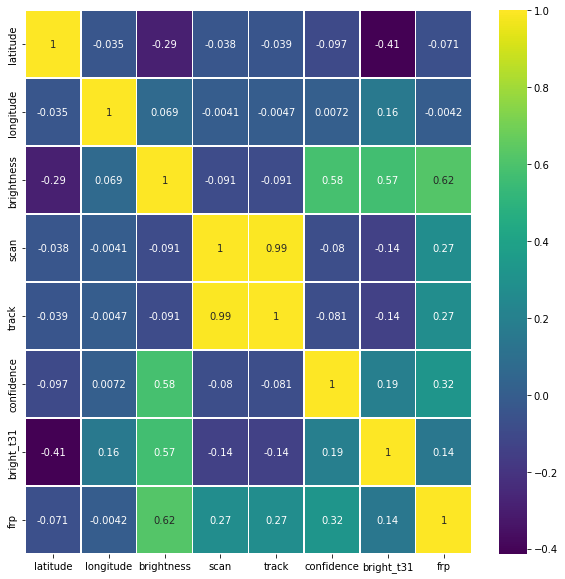

In [13]:
#Plot heat map to get the understanding of the data
plt.figure(figsize=(10, 10))
sns.heatmap(forest_fire_dataFrame.corr(),annot=True,cmap='viridis',linewidths=.5)

## Missing Data

In [14]:
#check for missing Data
def missing_data(data):
    total = data.isnull().sum()
    percent = (data.isnull().sum()/data.isnull().count()*100)
    tt = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    types = []
    for col in data.columns:
        dtype = str(data[col].dtype)
        types.append(dtype)
    tt['Types'] = types
    return(np.transpose(tt))

In [15]:
#Print the missing data for each column
missing_data(forest_fire_dataFrame)

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight
Total,0,0,0,0,0,0,0,0,0,0,0,0,0
Percent,0,0,0,0,0,0,0,0,0,0,0,0,0
Types,float64,float64,float64,float64,float64,object,object,object,int64,object,float64,float64,object


In [16]:
#check if there are any null values in each column
forest_fire_dataFrame.isna().sum()

latitude      0
longitude     0
brightness    0
scan          0
track         0
acq_date      0
acq_time      0
satellite     0
confidence    0
version       0
bright_t31    0
frp           0
daynight      0
dtype: int64

## Unique Values

In [17]:
#calculate unique values for each feature
def unique_values(data):
    total = data.count()
    tt = pd.DataFrame(total)
    tt.columns = ['Total']
    uniques = []
    for col in data.columns:
        unique = data[col].nunique()
        uniques.append(unique)
    tt['Uniques'] = uniques
    return(np.transpose(tt))

In [18]:
#Get the total number of unique values for each feature
unique_values(forest_fire_dataFrame)

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight
Total,547910,547910,547910,547910,547910,547910,547910,547910,547910,547910,547910,547910,547910
Uniques,511325,529441,9716,267,101,61,855,2,101,1,6744,29399,2


In [19]:
#Droping version feature since all rows has same value
forest_fire_dataFrame.drop(['version'], axis = 1)

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,bright_t31,frp,daynight
0,28.59904,-17.93748,320.31,3.73,1.81,2021-12-05,00:00,T,100,287.31,123.13,N
1,28.61983,-17.87544,319.83,3.78,1.82,2021-12-05,00:00,T,99,282.10,142.70,N
2,-14.97483,143.47408,328.09,1.03,1.01,2021-12-05,00:45,T,47,307.97,11.28,D
3,-14.98529,143.48222,325.15,1.03,1.01,2021-12-05,00:45,T,39,307.51,7.85,D
4,-14.61875,143.95247,335.98,1.05,1.02,2021-12-05,00:45,T,83,305.43,23.25,D
...,...,...,...,...,...,...,...,...,...,...,...,...
547905,28.61361,-17.91212,464.87,1.17,1.08,2021-11-15,23:28,T,100,323.06,1163.07,N
547906,28.61225,-17.92326,395.99,1.17,1.08,2021-11-15,23:28,T,100,307.05,284.86,N
547907,28.62323,-17.91364,326.78,1.17,1.08,2021-11-15,23:28,T,92,292.39,33.54,N
547908,28.62705,-17.90831,316.53,1.17,1.08,2021-11-15,23:28,T,69,288.02,21.32,N


# **Feature Engineering**

In [20]:
#create daynight map.
#daynight is 1 if its day and 0 if its night
daynight_map = {"D": 1, "N": 0}
forest_fire_dataFrame['daynight'] = forest_fire_dataFrame['daynight'].map(daynight_map)

In [21]:
#create satellite map.
#satellite map is 1 if its Terra and 0 if its Aqua
satellite_map = {"T": 1, "A": 0}
forest_fire_dataFrame['satellite'] = forest_fire_dataFrame['satellite'].map(satellite_map)

In [22]:
#check the dataset after adding new features daynight_map and satellite_map
forest_fire_dataFrame.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight
0,28.59904,-17.93748,320.31,3.73,1.81,2021-12-05,00:00,1,100,6.1NRT,287.31,123.13,0
1,28.61983,-17.87544,319.83,3.78,1.82,2021-12-05,00:00,1,99,6.1NRT,282.10,142.70,0
2,-14.97483,143.47408,328.09,1.03,1.01,2021-12-05,00:45,1,47,6.1NRT,307.97,11.28,1
3,-14.98529,143.48222,325.15,1.03,1.01,2021-12-05,00:45,1,39,6.1NRT,307.51,7.85,1
4,-14.61875,143.95247,335.98,1.05,1.02,2021-12-05,00:45,1,83,6.1NRT,305.43,23.25,1


In [23]:
print("Scan Values")
print(forest_fire_dataFrame['scan'].value_counts())
print()
# Name: acq_date, Length: 61, dtype: int64 : 61 days data
print("Date when Data was acquired")
print(forest_fire_dataFrame['acq_date'].value_counts())
print()

Scan Values
1.00    45323
1.01    32656
1.02    23006
1.03    17641
1.04    15333
        ...  
4.64      411
4.68      407
4.79      405
4.82      388
4.57      388
Name: scan, Length: 267, dtype: int64

Date when Data was acquired
2021-10-24    13198
2021-10-10    12750
2021-10-08    12749
2021-10-15    12446
2021-10-22    11691
              ...  
2021-11-27     6894
2021-10-18     6788
2021-10-25     6784
2021-10-30     6609
2021-11-12     6524
Name: acq_date, Length: 61, dtype: int64



# **Visualise Data**

In [24]:
#Extract acquired date
forest_fire_dataFrame['acq_date'] = pd.to_datetime(forest_fire_dataFrame['acq_date'])

In [25]:
#Extract month from acquired date
forest_fire_dataFrame['month'] = forest_fire_dataFrame['acq_date'].dt.month
forest_fire_dataFrame.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,confidence,version,bright_t31,frp,daynight,month
0,28.59904,-17.93748,320.31,3.73,1.81,2021-12-05,00:00,1,100,6.1NRT,287.31,123.13,0,12
1,28.61983,-17.87544,319.83,3.78,1.82,2021-12-05,00:00,1,99,6.1NRT,282.10,142.70,0,12
2,-14.97483,143.47408,328.09,1.03,1.01,2021-12-05,00:45,1,47,6.1NRT,307.97,11.28,1,12
3,-14.98529,143.48222,325.15,1.03,1.01,2021-12-05,00:45,1,39,6.1NRT,307.51,7.85,1,12
4,-14.61875,143.95247,335.98,1.05,1.02,2021-12-05,00:45,1,83,6.1NRT,305.43,23.25,1,12


In [26]:
#Counting number of records and percentage of rows per month
v1 = pd.DataFrame(forest_fire_dataFrame['month'].value_counts().reset_index(name='counts'))
v1 = v1[v1['index'] != 0]
v1

data = {
   "values": v1['counts'],
   "labels": v1['index'],
   "domain": {"column": 0},
   "name": "Month",
   "hoverinfo":"label+percent+name",
   "hole": .4,
   "type": "pie"
}
layout = go.Layout(title="<b>All Months in data</b>", legend=dict(x=0.1, y=1.1, orientation="h"))

data = [data]
fig = go.Figure(data = data, layout = layout)
fig.update_layout(title_x=0.5)
fig.show()

## **Confidence > 80**

In [27]:
#Seperating into another dataframe for confidence > 80
df_filtered = forest_fire_dataFrame[forest_fire_dataFrame['confidence'] > 80]

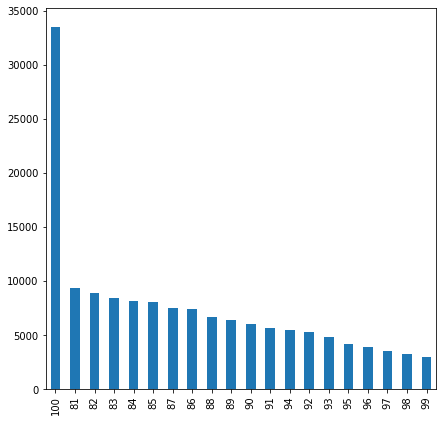

In [28]:
#Plotting number of records whose confidence is greater than 80
plt.figure(figsize=(7,7))
df_filtered['confidence'].value_counts().plot(kind='bar')

## **Visualize data in and around US**

In [29]:
#Getting localised data
usa_df = pd.read_csv('./usfd.csv')

In [30]:
#Finding city, state, country of data in and around US using geocoders
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="geoapiExercises")
def city_state_country(row):
    coord = f"{row['latitude']}, {row['longitude']}"
    if(type(geolocator.reverse(coord)) != str):
      pass
    location = geolocator.reverse(coord, exactly_one=True)
    address = location.raw['address']
    city = address.get('city', '')
    state = address.get('state', '')
    country = address.get('country', '')
    row['city'] = city
    row['state'] = state
    row['country'] = country
    return row

usa_df = usa_df.apply(city_state_country, axis=1)
print(usa_df)

     latitude  longitude  ...           state               country
0    19.39759 -155.31044  ...          Hawaii         United States
1    19.40784 -155.28192  ...          Hawaii         United States
2    18.92907  -70.34509  ...  Monseñor Nouel  República Dominicana
3    18.92756  -70.35754  ...  Monseñor Nouel  República Dominicana
4    35.28571  -90.80164  ...        Arkansas         United States
..        ...        ...  ...             ...                   ...
243  17.90560  -93.17871  ...         Chiapas                México
244  17.91881  -93.51501  ...         Tabasco                México
245  17.91312  -93.54510  ...         Tabasco                México
246  17.91579  -93.52094  ...         Tabasco                México
247  18.63713  -92.17372  ...        Campeche                México

[248 rows x 16 columns]


### **Slice of Data around US**

In [31]:
#In slice of data, identifying number of records associated with each country
v2 = pd.DataFrame(usa_df['country'].value_counts().reset_index(name='counts'))
v2 = v2[v2['index'] != 0]
v2

,index,counts
0,United States,149
1,México,79
2,Canada,15
3,República Dominicana,5


In [32]:
#Pie graph of sliced data
data = {
   "values": v2['counts'],
   "labels": v2['index'],
   "domain": {"column": 0},
   "name": "Country",
   "hoverinfo":"label+percent+name",
   "hole": .4,
   "type": "pie"
}
layout = go.Layout(title="<b>Ratio of Countries data</b>", legend=dict(x=0.1, y=1.1, orientation="h"))

data = [data]
fig = go.Figure(data = data, layout = layout)
fig.update_layout(title_x=0.5)
fig.show()

<BarContainer object of 248 artists>

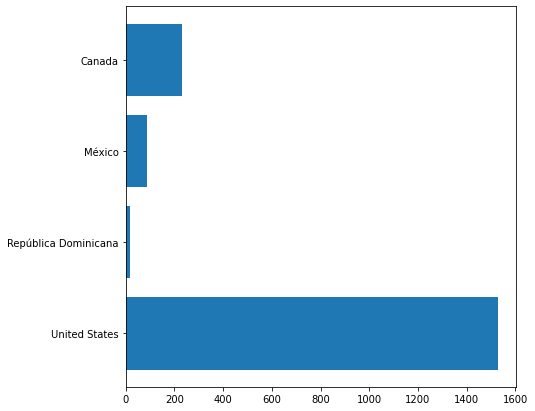

In [33]:
#All countries in slice of data
plt.figure(figsize=(7,7))
plt.barh(usa_df['country'], usa_df['frp'])

In [34]:
#storing 40 records with highest frp in a seperate dataframe
df4 = usa_df.nlargest(40,'frp')

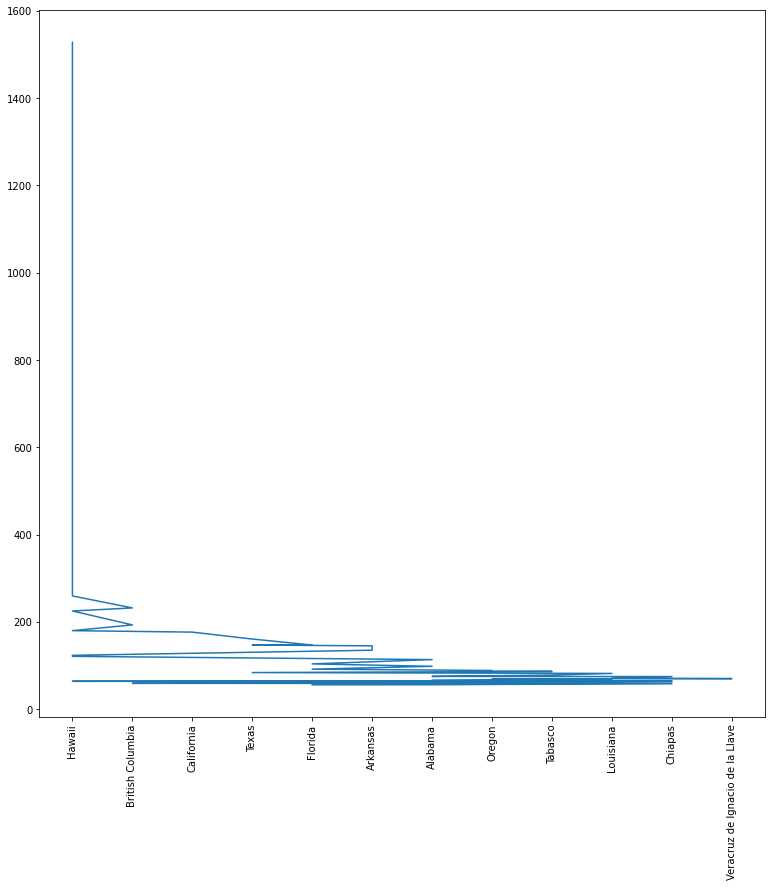

In [35]:
#plot statewise for those 40 records
plt.figure(figsize=(13,13))
plt.xticks(rotation = 90)
plt.plot(df4['state'], df4['frp'])

**Only USA**


In [36]:
#Visualizing only USA data in the slice
df3 = usa_df.loc[usa_df['country'] == 'United States']

<BarContainer object of 149 artists>

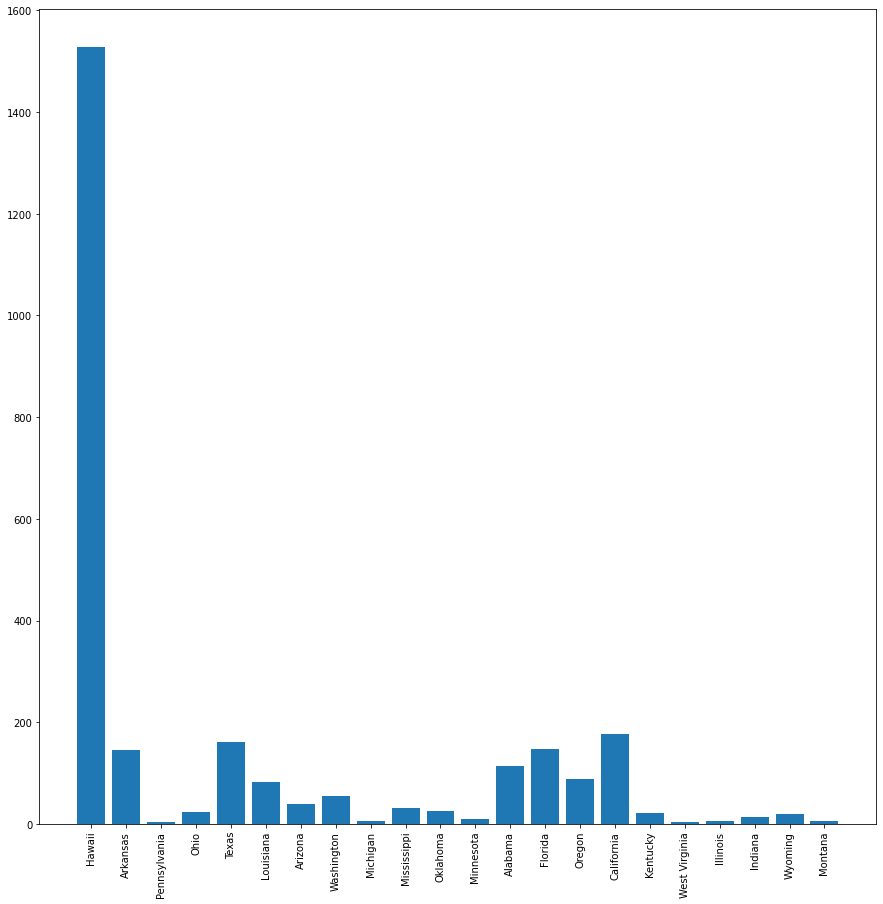

In [37]:
# States with high frp
plt.figure(figsize=(15,15))
plt.xticks(rotation = 90)
plt.bar(df3['state'], df3['frp'])

## **Visualise World Data**

In [38]:
#plotting for the world 
fig = px.scatter_mapbox(forest_fire_dataFrame, lat='latitude', lon='longitude', color="confidence", hover_data=['frp', 'brightness'])
fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [39]:
#Histogram for the satellite used
fig = px.histogram(forest_fire_dataFrame, x='latitude', y='longitude', color='satellite', hover_data=forest_fire_dataFrame.columns, template='seaborn')
fig.show()

## **Modelling**

In [40]:
y = forest_fire_dataFrame['confidence']
comp = forest_fire_dataFrame.drop(['confidence', 'acq_date', 'acq_time', 'bright_t31', 'brightness', 'satellite', 'daynight','version','track'], axis = 1)

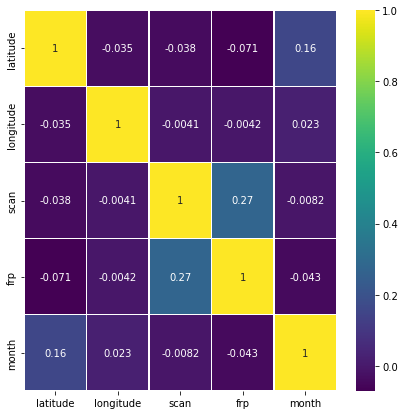

In [41]:
plt.figure(figsize=(7, 7))
sns.heatmap(comp.corr(),annot=True,cmap='viridis',linewidths=.5)

## Splitting Data for training and testing

In [42]:
Xtrain, Xtest, ytrain, ytest = train_test_split(comp.iloc[:, :5000], y, test_size=0.2)

Create RandomForestRegressor model

In [43]:
random_model = RandomForestRegressor(n_estimators=300, random_state = 42, n_jobs = -1)

In [44]:
#Fit
random_model.fit(Xtrain, ytrain)


RandomForestRegressor(n_estimators=300, n_jobs=-1, random_state=42)

Predict the model

In [45]:
y_result = random_model.predict(Xtest)
print(y_result)

[78.39       60.49       33.68666667 ... 65.16       48.55666667
 42.48      ]


Check the accuracy

In [46]:
#Checking the accuracy
random_model_accuracy = round(random_model.score(Xtrain, ytrain)*100,2)
print(round(random_model_accuracy, 2), '%')

94.33 %


Test the model

In [47]:
# Dump the model into pickle file
import pickle
with open('model.pickle', 'wb') as f:
    pickle.dump(random_model, f)

In [48]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score

cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

cross_val_score(RandomForestRegressor(), comp.iloc[:, :500], y, cv=cv)

array([0.58265695, 0.58047581, 0.58434146, 0.58156318, 0.58072436])

# **Alternative Solutions**

In [ ]:
# from sklearn.linear_model import LogisticRegression
# from sklearn.metrics import accuracy_score

# lr=LogisticRegression()
# lr.fit(Xtrain,ytrain)
# pred=lr.predict(Xtest)
# accuracy_score(pred,ytest)*100

In [ ]:
# lr_model_accuracy = round(lr.score(Xtrain, ytrain)*100,2)
# print(round(lr_model_accuracy, 2), '%')

In [ ]:
# X_data=forest_fire_dataFrame.drop(['confidence', 'acq_date', 'acq_time', 'bright_t31', 'brightness', 'satellite', 'daynight','version','track'], axis = 1)
# y_data=forest_fire_dataFrame['confidence']
# test_size = 0.4
# X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, test_size=test_size)

In [ ]:
# y_train=y_train.values.reshape(y_train.size,1)

In [ ]:
# def rec(m,n,tol):
#     if type(m)!='numpy.ndarray':
#         m=np.array(m)
#     if type(n)!='numpy.ndarray':
#         n=np.array(n)
#     l=m.size
#     percent = 0
#     for i in range(l):
#         if np.abs(10**m[i]-10**n[i])<=tol:
#             percent+=1
#     return 100*(percent/l)

In [ ]:
# tol_max=20

In [ ]:
# scaler = StandardScaler()

In [ ]:
# param_grid = {'C': [0.01,0.1,1, 10], 'epsilon': [10,1,0.1,0.01,0.001,0.0001], 'kernel': ['rbf']}

In [ ]:
# grid_SVR = GridSearchCV(SVR(),param_grid,refit=True,verbose=0,cv=5)
# grid_SVR.fit(scaler.fit_transform(X_train),scaler.fit_transform(y_train))

In [ ]:
# tree_model = DecisionTreeRegressor(max_depth=10,criterion='mae')
# tree_model.fit(scaler.fit_transform(X_train),scaler.fit_transform(y_train))

In [ ]:
# tree_model.score(X_test,y_test)

In [ ]:
# tree_model = DecisionTreeRegressor(max_depth=10,criterion='mae')
# tree_model.fit((Xtrain),(ytrain))

In [ ]:
# res_pred = tree_model.predict(Xtest)
# tree_model.score(Xtrain,ytrain)*100
# # score = accuracy_score(X_test, y_test)

In [ ]:
# df_new = pd.read_csv('./forestfires.csv')
# df_new.info()
# df_new.describe()
# df_new.isna().sum()
# unique_values(df_new)
# df_new['Log-area']=np.log10(df_new['area']+1)
# for i in df_new.describe().columns[:-2]:
#     df_new.plot.scatter(i,'Log-area',grid=True)

In [ ]:
# ls -lhrt

In [ ]:
# ! zip model.zip model.pickle

In [ ]:
# import pickle
# with open('model.pickle','rb') as f:
#     model = pickle.load(f)

In [ ]:
# test = Xtest[0:1]
# test['frp'] =40.0
# model.predict(test)